<a href="https://colab.research.google.com/github/seydaozer/DelayRemovalOnTVInterviews/blob/main/project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%%capture
# Local installation
!git clone https://github.com/speechbrain/speechbrain/
%cd /content/speechbrain/
!pip install -r requirements.txt
!pip install -e .

In [ ]:
!pip install speechbrain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 499.0/499.0 KB 28.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.3/190.3 KB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 61.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.5/109.5 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 555.3/555.3 KB 44.3 MB/s eta 0:00:00


In [ ]:
!pip install moviepy
!pip3 install imageio==2.4.1
!pip install --upgrade imageio-ffmpeg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 26.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for imageio: filename=imageio-2.4.1-py3-none-any.whl size=3303886 sha256=af6065bb8f26a1155250b9eb0948640ff824148319c4fa7856a90be1720584c0
  Stored in directory: /root/.cache/pip/wheels/be/7b/04/4d8d56f1d503e5c404f0de6018c0cfa592c71588a39b49e002
Successfully built imageio
  Attempting uninstall: imageio
    Found existing installation: imageio 2.9.0
    Uninstalling imageio-2.9.0:
      Successfully uninstalled imageio-2.9.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 25.8 MB/s eta 0:00:00


In [ ]:
from speechbrain.pretrained import VAD
import moviepy.editor
import torch
import torchaudio
from torchaudio import transforms
import matplotlib.pyplot as plt
from IPython.lib.display import Audio

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2383872/45929032 bytes (5.2%)4694016/45929032 bytes (10.2%)6938624/45929032 bytes (15.1%)8757248/45929032 bytes (19.1%)11337728/45929032 bytes (24.7%)13893632/45929032 bytes (30.3%)15302656/45929032 bytes (33.3%)17604608/45929032 bytes (38.3%)20774912/45929032 bytes (45.2%)23773184/45929032 bytes (51.8%)26787840/45929032 bytes (58.3%)29941760/45929032 bytes (65.2%)3

In [ ]:
video_path = "/content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/"
voice_path = "/content/gdrive/MyDrive/Graduation_Project/Inputs/Voices/"
output_path = "/content/gdrive/MyDrive/Graduation_Project/Outputs/"

In [ ]:
first_video = "ST01.mp4"
second_video = "T01.mp4"
first_voice = "ST01.wav"
second_voice = "T01.wav"

In [ ]:
# Voice activity detection
VAD = VAD.from_hparams(source="speechbrain/vad-crdnn-libriparty", savedir="pretrained_models/vad-crdnn-libriparty")

In [ ]:
# Video convert to audio
def video2audio(video_file, audio_file):
  video = moviepy.editor.VideoFileClip(video_file)
  audio = video.audio
  audio.write_audiofile(filename=audio_file, fps = VAD.sample_rate)
  return video

In [ ]:
# Audio convert to VAD's input format
def voice_transform(audio_file):
  waveform, sample_rate = torchaudio.load(audio_file, normalize=True)
  transform = transforms.Resample(sample_rate, VAD.sample_rate)
  waveform = transform(waveform)
  waveform = waveform[0].unsqueeze(0)
  torchaudio.save(audio_file, waveform, VAD.sample_rate)

In [ ]:
def prepare_inputs(video_name1, video_name2, voice_name1, voice_name2):
  video1 = video2audio(video_path+video_name1, voice_path+voice_name1)
  video2 = video2audio(video_path+video_name2, voice_path+voice_name2)
  voice_transform(voice_path+voice_name1)
  voice_transform(voice_path+voice_name2)
  return video1, video2

In [ ]:
def voice_print(audio_file):
  waveform, sample_rate = torchaudio.load(audio_file)
  waveform = waveform.squeeze()
  time = torch.linspace(0, waveform.shape[0]/sample_rate, steps=waveform.shape[0])
  plt.plot(time, waveform)
  display(Audio(audio_file))

In [ ]:
def clipDelay(clip, start, end):
    clip1 = clip.subclip(0, start)
    clip2 = clip.subclip(end, clip.duration)
    clip = moviepy.editor.concatenate_videoclips([clip1, clip2])
    return clip

In [ ]:
def findFirstSpeech(boundaries, index, bound):
  for i in reversed(range(index)):
      if boundaries[i][0] < bound:
        return i+1
  return index

In [ ]:
def delay_detection(first_boundaries, second_boundaries, video1, video2):
  i = len(first_boundaries)
  j = len(second_boundaries)

  while i > 0 and j > 0:
    i = i - 1
    j = j - 1
    if first_boundaries[i][0] < second_boundaries[j][0]: # ilk konuşan first video
      j = findFirstSpeech(second_boundaries, j, first_boundaries[i][1])
      if(second_boundaries[j][0] - first_boundaries[i][1]) > 2 : # there is a delay
        video2 = clipDelay(video2, first_boundaries[i][1], second_boundaries[j][0])
        video1 = clipDelay(video1, first_boundaries[i][1], second_boundaries[j][0])
      if j >= 1:
        i = findFirstSpeech(first_boundaries, i, second_boundaries[j-1][1])
        if(first_boundaries[i][0] - second_boundaries[j-1][1]) > 2: # there is a delay
          video1 = clipDelay(video1, second_boundaries[j-1][1], first_boundaries[i][0])
          video2 = clipDelay(video2, second_boundaries[j-1][1], first_boundaries[i][0])

    elif first_boundaries[i][0] > second_boundaries[j][0]: # ilk konuşan second
      i = findFirstSpeech(first_boundaries, i, second_boundaries[j][1])
      if(first_boundaries[i][0] - second_boundaries[j][1]) > 2 :# there is a delay
        video1 = clipDelay(video1, second_boundaries[j][1], first_boundaries[i][0])
        video2 = clipDelay(video2, second_boundaries[j][1], first_boundaries[i][0])
      if i >= 1:
        j = findFirstSpeech(second_boundaries, j, first_boundaries[i-1][1])
        if(second_boundaries[j][0] - first_boundaries[i-1][1]) > 2: # there is a delay
          video2 = clipDelay(video2, first_boundaries[i-1][1], second_boundaries[j][0])
          video1 = clipDelay(video1, first_boundaries[i-1][1], second_boundaries[j][0])

  return video1, video2

In [ ]:
def write_to_file(video1, video2):
  video1.write_videofile(video_path+"new_"+first_video)
  video2.write_videofile(video_path+"new_"+second_video)

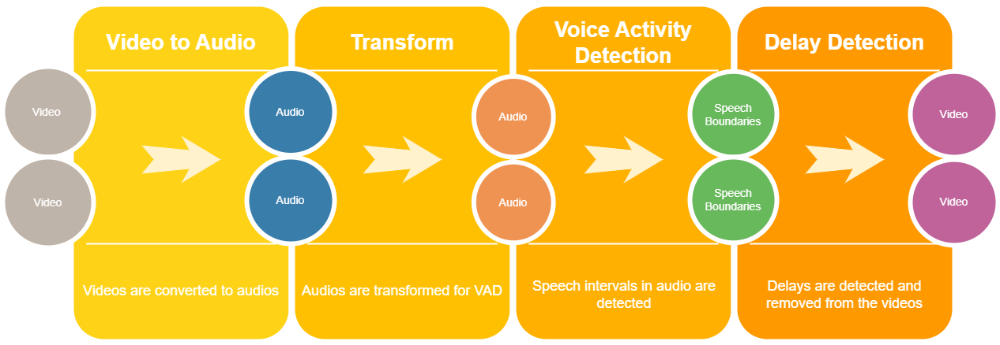

In [ ]:
video1, video2 = prepare_inputs(first_video, second_video, first_voice, second_voice)

[MoviePy] Writing audio in /content/gdrive/MyDrive/Graduation_Project/Inputs/Voices/ST01.wav


100%|██████████| 481/481 [00:00<00:00, 733.92it/s]

[MoviePy] Done.


[MoviePy] Writing audio in /content/gdrive/MyDrive/Graduation_Project/Inputs/Voices/T01.wav


100%|██████████| 481/481 [00:00<00:00, 760.75it/s]

[MoviePy] Done.


first video:


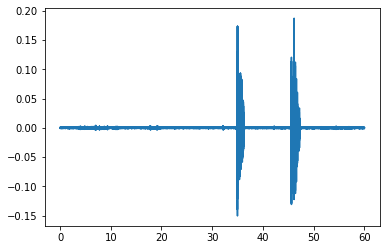

In [ ]:
print("first video:")
voice_print(voice_path+first_voice)

second video:


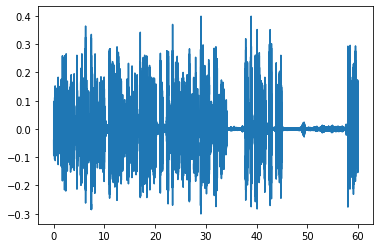

In [ ]:
print("second video:")
voice_print(voice_path+second_voice)

first video:


second video:


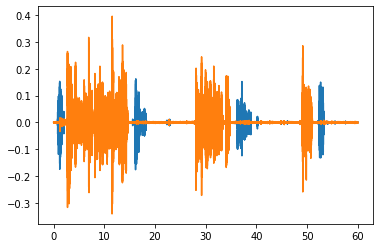

In [ ]:
print("first video:")
voice_print(voice_path+first_voice)
print("second video:")
voice_print(voice_path+second_voice)

In [ ]:
first_boundaries = VAD.get_speech_segments(voice_path+first_voice)
second_boundaries = VAD.get_speech_segments(voice_path+second_voice)

# Print the output
print("first video:")
VAD.save_boundaries(first_boundaries)
print("second video:")
VAD.save_boundaries(second_boundaries)

first video:
segment_001  0.00  2.15 SPEECH
segment_002  2.15  15.90 NON_SPEECH
segment_003  15.90  18.61 SPEECH
segment_004  18.61  36.02 NON_SPEECH
segment_005  36.02  39.99 SPEECH
segment_006  39.99  51.89 NON_SPEECH
segment_007  51.89  53.59 SPEECH
second video:
segment_001  0.00  2.35 NON_SPEECH
segment_002  2.35  15.13 SPEECH
segment_003  15.13  27.81 NON_SPEECH
segment_004  27.81  35.41 SPEECH
segment_005  35.41  48.63 NON_SPEECH
segment_006  48.63  51.63 SPEECH


In [ ]:
new_video1, new_video2 = delay_detection(first_boundaries.tolist(), second_boundaries.tolist(), video1, video2)

In [ ]:
write_to_file(new_video1, new_video2)

[MoviePy] >>>> Building video /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_ST01.mp4
[MoviePy] Writing audio in new_ST01TEMP_MPY_wvf_snd.mp3


100%|██████████| 932/932 [00:02<00:00, 450.53it/s]

[MoviePy] Done.
[MoviePy] Writing video /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_ST01.mp4



100%|██████████| 1267/1267 [00:39<00:00, 32.36it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_ST01.mp4 

[MoviePy] >>>> Building video /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_T01.mp4
[MoviePy] Writing audio in new_T01TEMP_MPY_wvf_snd.mp3


100%|██████████| 930/930 [00:01<00:00, 772.49it/s]

[MoviePy] Done.
[MoviePy] Writing video /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_T01.mp4



100%|██████████| 1265/1265 [00:37<00:00, 34.00it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /content/gdrive/MyDrive/Graduation_Project/Inputs/Videos/new_T01.mp4 



[MoviePy] Writing audio in /content/gdrive/MyDrive/Graduation_Project/Inputs/Voices/new_ST01.wav


100%|██████████| 339/339 [00:00<00:00, 683.77it/s]

[MoviePy] Done.


first video


[MoviePy] Writing audio in /content/gdrive/MyDrive/Graduation_Project/Inputs/Voices/new_T01.wav


100%|██████████| 338/338 [00:00<00:00, 598.02it/s]

[MoviePy] Done.


second video


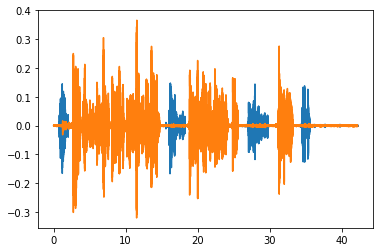

In [ ]:
new_video1 = video2audio(video_path+"new_"+first_video, voice_path+"new_"+first_voice)
voice_transform(voice_path+"new_"+first_voice)
print("first video")
voice_print(voice_path+"new_"+first_voice)

new_video2 = video2audio(video_path+"new_"+second_video, voice_path+"new_"+second_voice)
voice_transform(voice_path+"new_"+second_voice)
print("second video")
voice_print(voice_path+"new_"+second_voice)

first video


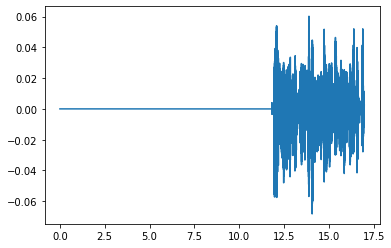

In [ ]:
print("first video")
voice_print(voice_path+"new_"+first_voice)

second_video


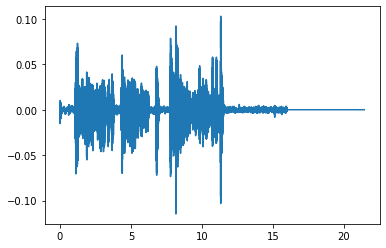

In [ ]:
print("second_video")
voice_print(voice_path+second_voice)